# Get Data Ready

These scans come with expert-annotated segmentation masks that delineate the tumor into various sub-regions, such as the necrotic and non-enhancing tumor core, the peritumoral edema, and the enhancing tumor.

Annotations (labels):

    Label 0: Not Tumor (NT) volume
    Label 1: Necrotic and non-enhancing tumor core (NCR/NET)
    Label 2: Peritumoral edema (ED)
    Label 3: Missing (No pixels in all the volumes contain label 3)
    Label 4: GD-enhancing tumor (ET)

As there are no pixels with the label 3, we will be replacing label 3 with label 4 so that there is continuity between the labels.

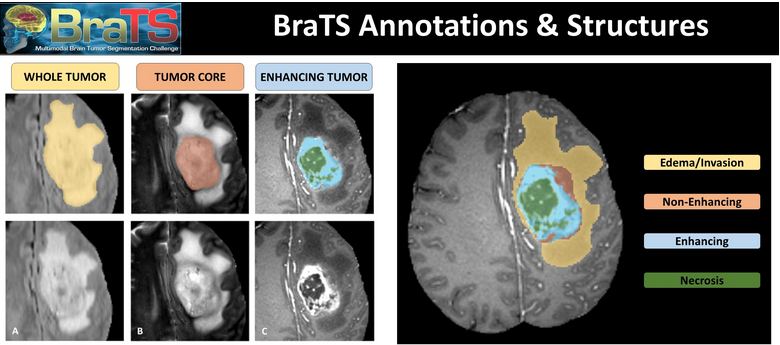

In [1]:
TRAIN_DATA_PATH = "./archive/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/"
VALIDATE_DATA_PATH = "./archive/BraTS2020_ValidationData/MICCAI_BraTS2020_ValidationData/"

In [2]:
import os
import cv2
import random
import glob
import PIL
import shutil
import numpy as np
import pandas as pd
import matplotlib
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import nilearn.plotting as nlplt
from skimage import data
from skimage.util import montage
import skimage.transform as skTrans
from skimage.transform import rotate
from skimage.transform import resize
from PIL import Image, ImageOps
import nibabel as nib
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report


In [3]:
old_name = TRAIN_DATA_PATH + "BraTS20_Training_355/W39_1998.09.19_Segm.nii"
new_name = TRAIN_DATA_PATH + "BraTS20_Training_355/BraTS20_Training_355_seg.nii"

# renaming the file
try:
    os.rename(old_name, new_name)
    print("File has been re-named successfully!")
except:
    print("File is already renamed!")


File is already renamed!


In [4]:
# load .nii file as a numpy array
test_image_flair = nib.load(TRAIN_DATA_PATH + "BraTS20_Training_355/BraTS20_Training_355_flair.nii").get_fdata()
print("Shape: ", test_image_flair.shape)
print("Dtype: ", test_image_flair.dtype)

Shape:  (240, 240, 155)
Dtype:  float64


In [5]:
print("Min: ", test_image_flair.min())
print("Max: ", test_image_flair.max())

Min:  0.0
Max:  1854.603271484375


In [6]:
# Scale the test_image_flair array and then reshape it back to its original dimensions.
# This ensures the data is normalized/standardized for model input without altering its spatial structure.
scaler = MinMaxScaler()
test_image_flair = scaler.fit_transform(test_image_flair.reshape(-1, test_image_flair.shape[-1])).reshape(test_image_flair.shape)

In [7]:
print("Min: ", test_image_flair.min())
print("Max: ", test_image_flair.max())

Min:  0.0
Max:  1.0


In [8]:


# rescaling t1
test_image_t1 = nib.load(TRAIN_DATA_PATH + 'BraTS20_Training_355/BraTS20_Training_355_t1.nii').get_fdata()
test_image_t1 = scaler.fit_transform(test_image_t1.reshape(-1, test_image_t1.shape[-1])).reshape(test_image_t1.shape)

# rescaling t1ce
test_image_t1ce = nib.load(TRAIN_DATA_PATH + 'BraTS20_Training_355/BraTS20_Training_355_t1ce.nii').get_fdata()
test_image_t1ce = scaler.fit_transform(test_image_t1ce.reshape(-1, test_image_t1ce.shape[-1])).reshape(test_image_t1ce.shape)

# rescaling t2
test_image_t2 = nib.load(TRAIN_DATA_PATH + 'BraTS20_Training_355/BraTS20_Training_355_t2.nii').get_fdata()
test_image_t2 = scaler.fit_transform(test_image_t2.reshape(-1, test_image_t2.shape[-1])).reshape(test_image_t2.shape)

# we will not rescale the mask
test_image_seg = nib.load(TRAIN_DATA_PATH + 'BraTS20_Training_355/BraTS20_Training_355_seg.nii').get_fdata()



Slice Number: 95


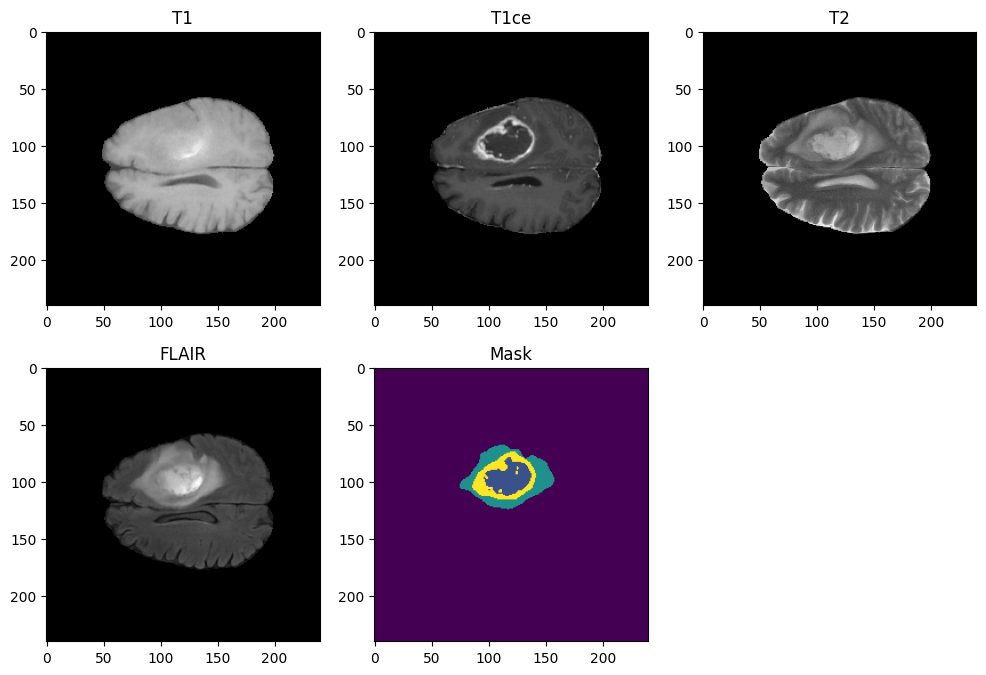

In [9]:
slice = 95

print("Slice Number: " + str(slice))

plt.figure(figsize=(12, 8))

# T1
plt.subplot(2, 3, 1)
plt.imshow(test_image_t1[:,:,slice], cmap='gray')
plt.title('T1')

# T1ce
plt.subplot(2, 3, 2)
plt.imshow(test_image_t1ce[:,:,slice], cmap='gray')
plt.title('T1ce')

# T2
plt.subplot(2, 3, 3)
plt.imshow(test_image_t2[:,:,slice], cmap='gray')
plt.title('T2')

# Flair
plt.subplot(2, 3, 4)
plt.imshow(test_image_flair[:,:,slice], cmap='gray')
plt.title('FLAIR')

# Mask
plt.subplot(2, 3, 5)
plt.imshow(test_image_seg[:,:,slice])
plt.title('Mask')
plt.show()

* To optimize our model, we will exclude the T1 modality since its enhanced counterpart, T1ce, provides better clarity. Similarly, we will omit the T2 modality because the fluids it highlights could negatively impact our predictions. Instead, the T2-FLAIR modality, which effectively highlights affected regions by suppressing fluid signals, will be more beneficial for our training.

## NIfTI Files (.nii)
The brain scans in this dataset are stored in NIfTI (Neuroimaging Informatics Technology Initiative) format. NIfTI is a specialized medical imaging format that:

- Provides 3D digital representation of anatomical structures (brain in our case)
- Efficiently handles complex multi-dimensional medical imaging data  
- Includes important metadata about:
  - Spatial orientation
  - Image scaling
  - Other scan parameters

## Data Structure
Let's analyze the dimensions of our imaging data:
- Each modality scan (T1ce, FLAIR) has the same shape
- The segmentation masks match these dimensions exactly
- This consistent structure allows direct pixel-wise comparison


In [10]:
# Modality shape
print("Modality: ", test_image_t1.shape)

# Segmentation shape
print("Segmentation: ", test_image_seg.shape)



Modality:  (240, 240, 155)
Segmentation:  (240, 240, 155)


* As we can see, the modalities and segmentations have 3 dimensions. Each dimension consists of a series of two-dimensional images, known as slices, which all contain the same number of pixels and are stacked together to create this 3D representation. For instance, in our previous example, we displayed the 95th slice of a certain dimension


1.  Axial (Transverse) Plane: This plane divides the body into upper and lower parts and is perpendicular to the long axis of the body. In brain imaging, an axial slice is a horizontal cut through the brain.
2.  Coronal (Frontal) Plane: This plane divides the body into front (anterior) and back (posterior) parts. A coronal slice in brain imaging is a vertical cut from one side of the head to the other, dividing the brain into front and back sections.
3.  Sagittal (Lateral) Plane: This plane divides the body into left and right parts. A sagittal slice in brain imaging is a vertical cut from front to back, dividing the brain into left and right sections.



Slice number: 95


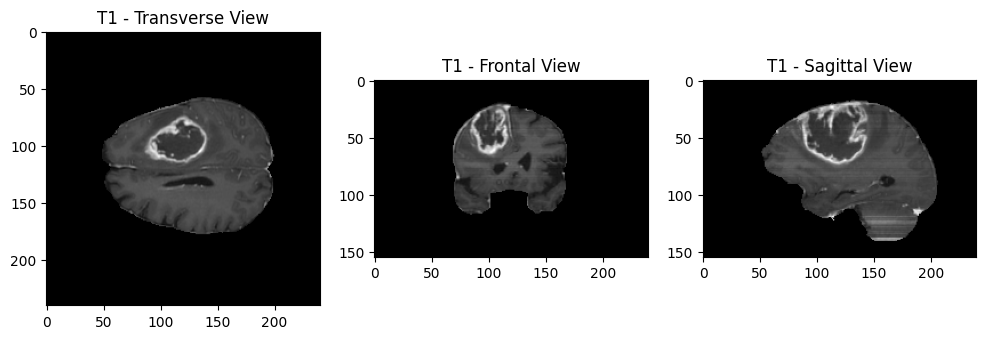

In [11]:
slice = 95

print("Slice number: " + str(slice))

plt.figure(figsize=(12, 8))

# Apply a 90° rotation with an automatic resizing, otherwise the display is less obvious to analyze
# T1 - Transverse View
plt.subplot(1, 3, 1)
plt.imshow(test_image_t1ce[:,:,slice], cmap='gray')
plt.title('T1 - Transverse View')

# T1 - Frontal View
plt.subplot(1, 3, 2)
plt.imshow(rotate(test_image_t1ce[:,slice,:], 90, resize=True), cmap='gray')
plt.title('T1 - Frontal View')

# T1 - Sagittal View
plt.subplot(1, 3, 3)
plt.imshow(rotate(test_image_t1ce[slice,:,:], 90, resize=True), cmap='gray')
plt.title('T1 - Sagittal View')
plt.show()

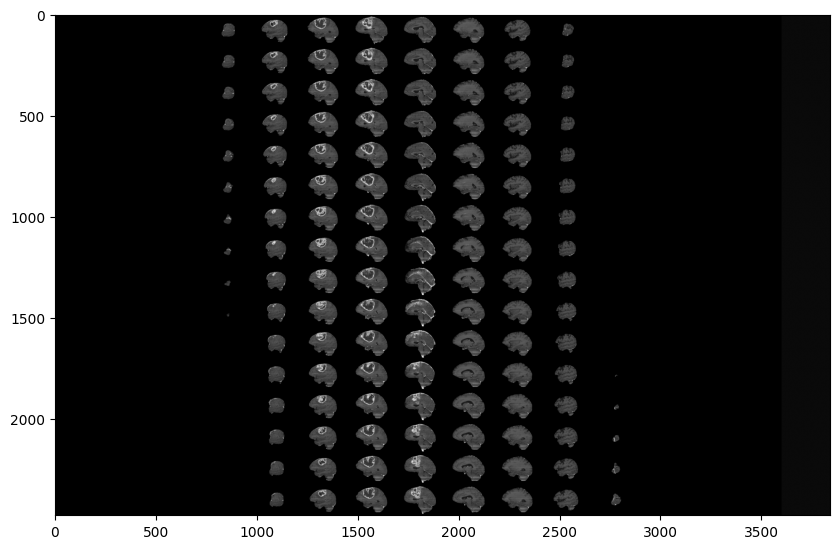

In [12]:
plt.figure(figsize=(10, 10))
plt.subplot(1, 1, 1)

# montage allows us to concatenate multiple images of the same size horizontally and vertically
plt.imshow(rotate(montage(test_image_t1ce[:,:,:]), 90, resize=True), cmap ='gray');


In [52]:
def plot_3d_nifti(nifti_data, threshold=0.5, opacity=0.7, point_size=1, colorscale='Viridis'):
    """
    Create an interactive 3D visualization of NIfTI data using plotly.
    
    Parameters:
    -----------
    nifti_data : ndarray
        3D numpy array containing the NIfTI image data
    threshold : float, optional (default=0.5)
        Value between 0 and 1 to threshold the data, relative to data maximum
    opacity : float, optional (default=0.7)
        Opacity of the plotted points (0 to 1)
    point_size : int, optional (default=1)
        Size of the plotted points
    colorscale : str, optional (default='Viridis')
        Colorscale to use for the visualization
        
    Returns:
    --------
    None : Displays the interactive 3D plot
    """
    
    # Get the shape of the data
    x_dim, y_dim, z_dim = nifti_data.shape
    
    # Create binary mask using the threshold
    threshold_value = threshold * nifti_data.max()
    mask = nifti_data > threshold_value
    
    # Get coordinates of points above threshold
    points = np.array(np.where(mask)).T
    
    # Create the 3D scatter plot
    fig = go.Figure(data=[
        go.Scatter3d(
            x=points[:, 0],
            y=points[:, 1],
            z=points[:, 2],
            mode='markers',
            marker=dict(
                size=point_size,
                color=nifti_data[mask],  # Use actual values for color
                colorscale=colorscale,
                opacity=opacity
            ),
            hovertemplate='x: %{x}<br>y: %{y}<br>z: %{z}<br>value: %{marker.color}<extra></extra>'
        )
    ])
    
    # Update the layout
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y', 
            zaxis_title='Z',
            aspectmode='data'  # Preserve aspect ratio
        ),
        title=dict(
            text='3D Visualization of NIfTI Data',
            x=0.5,
            y=0.95
        ),
        showlegend=False
    )
    
    # Show the plot
    fig.show()

plot_3d_nifti(test_image_t2)

In [14]:
test_image_t1ce.shape

(240, 240, 155)

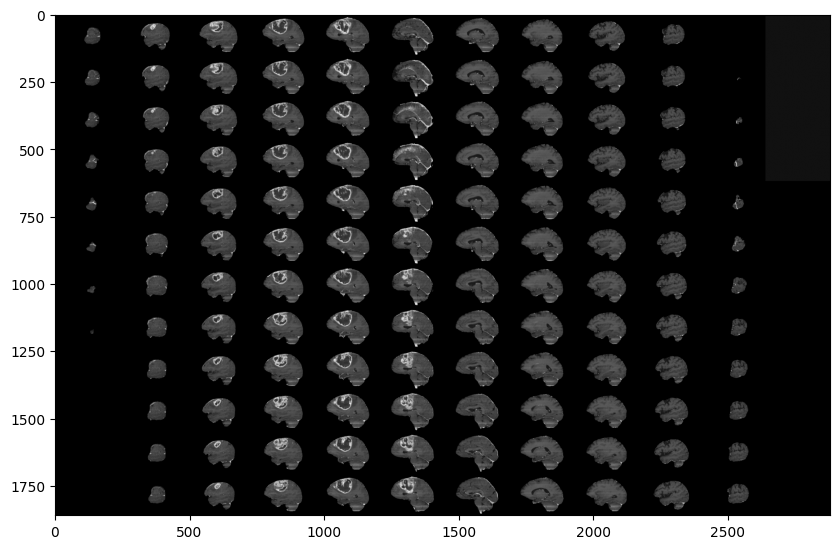

In [15]:


# Skip 50:-50 slices since there is not much to see
plt.figure(figsize=(10, 10))
plt.subplot(1, 1, 1)
plt.imshow(rotate(montage(test_image_t1ce[50:-50,:,:]), 90, resize=True), cmap ='gray');



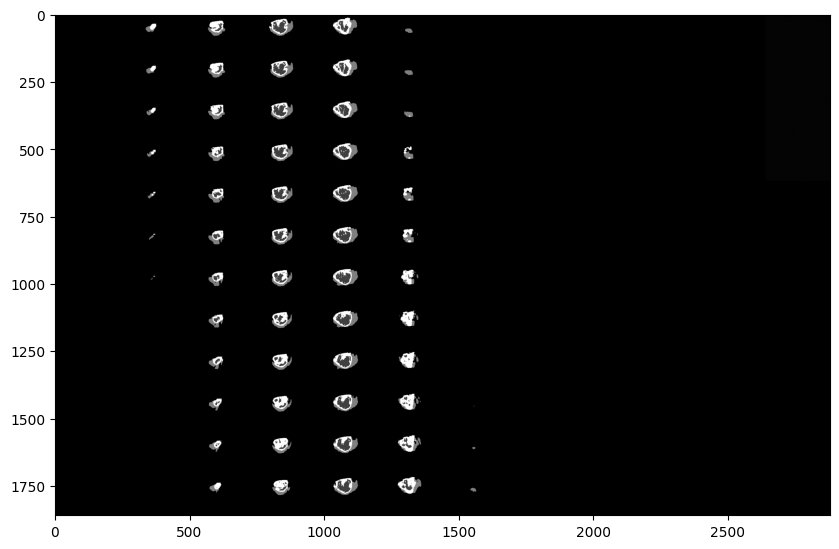

In [16]:
# Skip 50:-50 slices since there is not much to see
plt.figure(figsize=(10, 10))
plt.subplot(1, 1, 1)
plt.imshow(rotate(montage(test_image_seg[50:-50,:,:]), 90, resize=True), cmap ='gray');



* By focusing on a range of slices that contain meaningful content, we can better understand the anatomical structures and the regions where abnormalities, such as tumors, may be present. This approach helps in identifying the slices that are most relevant for analysis and segmentation. This analysis applies to all other modalities and planes as well. The segmented images by experts also reflect this pattern, as they concentrate on the slices containing significant information. Slices that do not capture much of the brain's anatomy are often left unsegmented, as they provide little to no valuable data for diagnosis or analysis.




## segmentations provided by the experts. These segmentations provide critical information about the tumor:

1. Location: Identifies the exact location of the tumor in the brain.
2. Size and Shape: Measures the tumor's dimensions and form.
3. Type: Helps differentiate between various tumor types.
4. Heterogeneity: Reveals different components within the tumor (e.g., solid tissue, necrotic areas).
5. Surrounding Tissue Involvement: Shows how the tumor interacts with adjacent brain structures.
6. Cross-Modality Comparison: Provides a comprehensive view by comparing different imaging modalities.



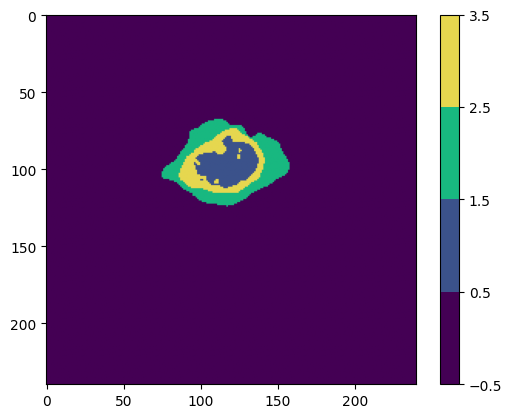

In [17]:


# Plotting the segmantation
cmap = matplotlib.colors.ListedColormap(['#440054', '#3b528b', '#18b880', '#e6d74f'])
norm = matplotlib.colors.BoundaryNorm([-0.5, 0.5, 1.5, 2.5, 3.5], cmap.N)

# plotting the 95th slice
plt.imshow(test_image_seg[:,:,95], cmap=cmap, norm=norm)
plt.colorbar()
plt.show()



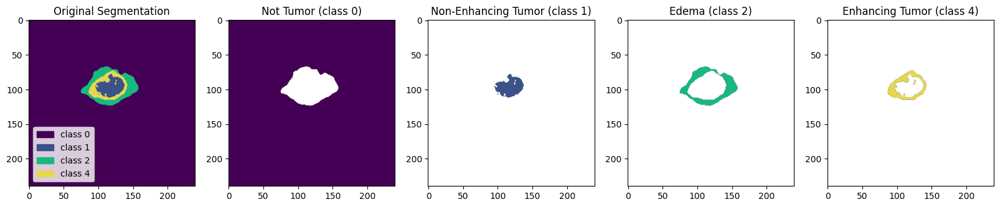

In [18]:
# Isolation of class 0
seg_0 = test_image_seg.copy()
seg_0[seg_0 != 0] = np.nan

# Isolation of class 1
seg_1 = test_image_seg.copy()
seg_1[seg_1 != 1] = np.nan

# Isolation of class 2
seg_2 = test_image_seg.copy()
seg_2[seg_2 != 2] = np.nan

# Isolation of class 4
seg_4 = test_image_seg.copy()
seg_4[seg_4 != 4] = np.nan

# Define legend
class_names = ['class 0', 'class 1', 'class 2', 'class 4']
legend = [plt.Rectangle((0, 0), 1, 1, color=cmap(i), label=class_names[i]) for i in range(len(class_names))]

fig, ax = plt.subplots(1, 5, figsize=(20, 20))

ax[0].imshow(test_image_seg[:,:, slice], cmap=cmap, norm=norm)
ax[0].set_title('Original Segmentation')
ax[0].legend(handles=legend, loc='lower left')

ax[1].imshow(seg_0[:,:, slice], cmap=cmap, norm=norm)
ax[1].set_title('Not Tumor (class 0)')

ax[2].imshow(seg_1[:,:, slice], cmap=cmap, norm=norm)
ax[2].set_title('Non-Enhancing Tumor (class 1)')

ax[3].imshow(seg_2[:,:, slice], cmap=cmap, norm=norm)
ax[3].set_title('Edema (class 2)')

ax[4].imshow(seg_4[:,:, slice], cmap=cmap, norm=norm)
ax[4].set_title('Enhancing Tumor (class 4)')

plt.show()

## To summarize our data exploration:

1. Modalities: Each sample/patient has 4 different modalities (T1, T1CE, T2, and FLAIR), accompanied by a segmentation indicating tumor areas.
2. Selected Modalities: We will focus on T1CE and FLAIR as they provide complementary information about the brain's anatomy and tissue contrast.
3. 3D Images: Each image is 3D and can be analyzed through 3 different planes composed of 2D slices.
4. Informative Slices: Many slices contain little or no information. We will use slices in the (50:-50) interval. You can customize this range, but note that changing it may affect training time.
5. Segmentation Classes: Segmentation images contain 1 to 4 classes. Class 4 will be reassigned to 3 since class 3 is missing.
6. Background Class: Class 0 (background) is over-represented. Cropping might remove important information, so we will keep the images as they are.


In [19]:
# lists of directories with studies
train_and_val_directories = [f.path for f in os.scandir(TRAIN_DATA_PATH) if f.is_dir()]

def pathListIntoIds(dirList):
    x = []
    for i in range(0,len(dirList)):
        x.append(dirList[i][dirList[i].rfind('/')+1:])
    return x

train_and_test_ids = pathListIntoIds(train_and_val_directories);

train_test_ids, val_ids = train_test_split(train_and_test_ids,test_size=0.1)
train_ids, test_ids = train_test_split(train_test_ids,test_size=0.1)

In [20]:
print(f"Train length: {len(train_ids)}")
print(f"Validation length: {len(val_ids)}")
print(f"Test length: {len(test_ids)}")

Train length: 298
Validation length: 37
Test length: 34


In [21]:
train_ids[:5] , val_ids[:5] , test_ids[:5]

(['BraTS20_Training_354',
  'BraTS20_Training_334',
  'BraTS20_Training_058',
  'BraTS20_Training_352',
  'BraTS20_Training_318'],
 ['BraTS20_Training_115',
  'BraTS20_Training_351',
  'BraTS20_Training_298',
  'BraTS20_Training_350',
  'BraTS20_Training_198'],
 ['BraTS20_Training_164',
  'BraTS20_Training_278',
  'BraTS20_Training_336',
  'BraTS20_Training_006',
  'BraTS20_Training_264'])

In [22]:
import torch
from torch.utils.data import DataLoader , Dataset
# from torchvision import datasets, transforms

In [23]:


# Define seg-areas
SEGMENT_CLASSES = {
    0 : 'NOT tumor',
    1 : 'NECROTIC/CORE', # or NON-ENHANCING tumor CORE
    2 : 'EDEMA',
    3 : 'ENHANCING' # original 4 -> converted into 3
}

# Select Slices and Image Size
VOLUME_SLICES = 10
VOLUME_START_AT = 22 # first slice of volume that we will include
IMG_SIZE = 240

class BrainTumorDataset(Dataset):
    def __init__(self, list_IDs, img_size=(IMG_SIZE,IMG_SIZE), n_channels=2):
        self.img_size = img_size
        self.list_IDs = list_IDs
        self.n_channels = n_channels

    def __len__(self):
        return len(self.list_IDs)

    def __getitem__(self, idx):
        case_id = self.list_IDs[idx]
        case_path = os.path.join(TRAIN_DATA_PATH, case_id)

        # Load the volumes
        flair_path = os.path.join(case_path, f'{case_id}_flair.nii')
        t1ce_path = os.path.join(case_path, f'{case_id}_t1ce.nii')
        seg_path = os.path.join(case_path, f'{case_id}_seg.nii')

        flair = nib.load(flair_path).get_fdata()
        t1ce = nib.load(t1ce_path).get_fdata()
        seg = nib.load(seg_path).get_fdata()

        # Initialize arrays
        X = torch.zeros((self.n_channels, VOLUME_SLICES, *self.img_size))
        Y = torch.zeros((4, VOLUME_SLICES, *self.img_size))

        # Process each slice
        for j in range(VOLUME_SLICES):
            # Resize and normalize input images
            flair_slice = cv2.resize(flair[:,:,j+VOLUME_START_AT], self.img_size)
            t1ce_slice = cv2.resize(t1ce[:,:,j+VOLUME_START_AT], self.img_size)
            
            X[0,j] = torch.from_numpy(flair_slice)
            X[1,j] = torch.from_numpy(t1ce_slice)

            # Process segmentation mask
            seg_slice = seg[:,:,j+VOLUME_START_AT]
            seg_slice[seg_slice == 4] = 3  # Convert class 4 to 3
            
            # Create one-hot encoded mask
            seg_tensor = torch.from_numpy(seg_slice).long()
            Y[:,j] = torch.nn.functional.one_hot(seg_tensor, 4).permute(2,0,1).float()
            Y[:,j] = torch.nn.functional.interpolate(Y[:,j].unsqueeze(0), size=self.img_size).squeeze(0)

        # Normalize input
        X = X / X.max()

        return X, Y

# Create data loaders
train_dataset = BrainTumorDataset(train_ids)
val_dataset = BrainTumorDataset(val_ids)
test_dataset = BrainTumorDataset(test_ids)

train_loader = DataLoader(train_dataset, batch_size=2, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=2)
test_loader = DataLoader(test_dataset, batch_size=2)



In [24]:
train_loader.__len__() , val_loader.__len__() , test_loader.__len__()

(149, 19, 17)

In [25]:

train_dataset[0][0].shape , train_dataset[0][1].shape

(torch.Size([2, 10, 240, 240]), torch.Size([4, 10, 240, 240]))

In [26]:
train_dataset[0][0][0,0,:,:][train_dataset[0][0][0,0,:,:]>1]

tensor([])

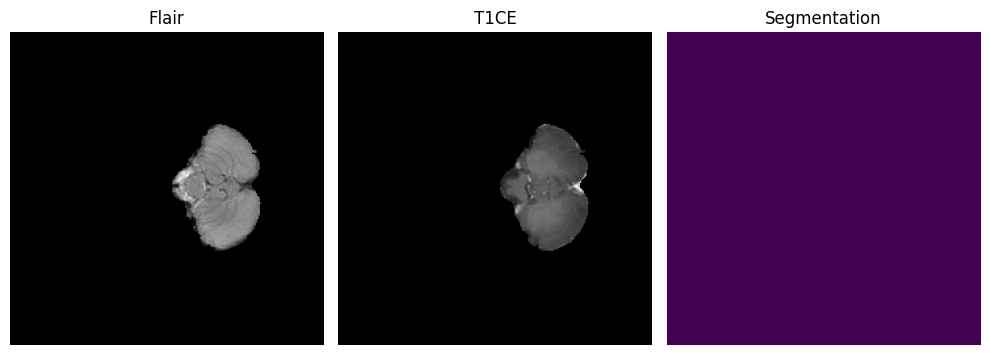

In [27]:
# Define a function to display one slice and its segmentation
def display_slice_and_segmentation(flair, t1ce, segmentation):
    fig, axes = plt.subplots(1, 3, figsize=(10, 5))

    axes[0].imshow(flair, cmap='gray')
    axes[0].set_title('Flair')
    axes[0].axis('off')

    axes[1].imshow(t1ce, cmap='gray')
    axes[1].set_title('T1CE')
    axes[1].axis('off')

    axes[2].imshow(segmentation) # Displaying segmentation
    axes[2].set_title('Segmentation')
    axes[2].axis('off')

    plt.tight_layout()
    plt.show()

# Get a sample from the dataset
X_batch, Y_batch = train_dataset[0]  # Get first sample from dataset

# Get specific slice
slice_idx = VOLUME_SLICES - 10  # Choose slice index
flair_slice = X_batch[0, slice_idx].numpy()  # Get FLAIR slice
t1ce_slice = X_batch[1, slice_idx].numpy()   # Get T1CE slice

# Convert one-hot encoded segmentation back to categorical
seg_slice = torch.argmax(Y_batch[:, slice_idx], dim=0).numpy()

# Display the slices
display_slice_and_segmentation(flair_slice, t1ce_slice, seg_slice)

In [28]:
X_batch.shape , Y_batch.shape

(torch.Size([2, 10, 240, 240]), torch.Size([4, 10, 240, 240]))

---

# Create Model

In [29]:
from torch import nn

## DoubleConv

In [30]:


class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
    def forward(self, x):
        return self.double_conv(x)



## DilatedConv

In [31]:

class DilatedConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        
        # Three parallel dilated convolution paths with BatchNorm
        self.dilation1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1, dilation=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        self.dilation2 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=2, dilation=2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        self.dilation3 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=3, dilation=3),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        # 1x1 convolution with BatchNorm
        self.conv1x1 = nn.Sequential(
            nn.Conv2d(out_channels * 3, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
    def forward(self, x):
        # Apply dilated convolutions
        d1 = self.dilation1(x)
        d2 = self.dilation2(x)
        d3 = self.dilation3(x)
        
        # Concatenate the outputs
        out = torch.cat([d1, d2, d3], dim=1)
        
        # Apply 1x1 convolution
        out = self.conv1x1(out)
        
        return out



In [32]:
import torchvision

## Deformable Conv

In [33]:
from torch import nn

In [34]:
class DeformableConv2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1, dilation=1):
        super(DeformableConv2d, self).__init__()
        
        # Ensure padding matches the deformable conv
        self.padding = padding
        
        # Offset conv - generates the offset fields
        self.offset_conv = nn.Conv2d(in_channels, 
                                   2 * kernel_size * kernel_size,  # 2 coordinates (x,y) for each kernel point
                                   kernel_size=3, 
                                   padding=1)  # Use padding=1 for 3x3 conv
        
        # Modulation conv - generates the modulation scalar
        self.modulator_conv = nn.Conv2d(in_channels, 
                                      kernel_size * kernel_size, 
                                      kernel_size=3, 
                                      padding=1)  # Use padding=1 for 3x3 conv
        
        # Deformable conv
        self.deform_conv = torchvision.ops.DeformConv2d(in_channels, 
                                                       out_channels,
                                                       kernel_size=kernel_size,
                                                       stride=stride,
                                                       padding=padding,
                                                       dilation=dilation)
        
    def forward(self, x):
        # Get offset field
        offset = self.offset_conv(x)
        
        # Get modulation scalar
        modulator = torch.sigmoid(self.modulator_conv(x))
        
        # Apply deformable convolution
        return self.deform_conv(x, offset, modulator)

class DilatedandDeformableConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        
        # Three parallel dilated and deformable convolution paths with BatchNorm
        self.dilation1 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, padding=1, dilation=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        self.dilation2 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, padding=2, dilation=2),  # Padding matches dilation
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        self.dilation3 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, padding=3, dilation=3),  # Padding matches dilation
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        # 1x1 convolution with BatchNorm
        self.conv1x1 = nn.Sequential(
            nn.Conv2d(out_channels * 3, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
    def forward(self, x):
        # Apply dilated and deformable convolutions
        d1 = self.dilation1(x)
        d2 = self.dilation2(x)
        d3 = self.dilation3(x)
        
        # Concatenate the outputs
        out = torch.cat([d1, d2, d3], dim=1)
        
        # Apply 1x1 convolution
        out = self.conv1x1(out)
        
        return out

## IncDecDilationRate

In [35]:
class IncDecDilationRate(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        
        # Path 1: Single deformable conv with dilation=1
        self.path1 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, dilation=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        # Path 2: Sequence of deformable convs with increasing then decreasing dilation
        self.path2 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, dilation=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=2, padding=2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=2, padding=2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        # Path 3: Sequence of deformable convs with varying dilation rates
        self.path3 = nn.Sequential(
            DeformableConv2d(in_channels, out_channels, dilation=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=2, padding=2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=4, padding=4),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=2, padding=2),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            
            DeformableConv2d(out_channels, out_channels, dilation=1, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
        # 1x1 convolution with BatchNorm to combine all paths
        self.conv1x1 = nn.Sequential(
            nn.Conv2d(out_channels * 3, out_channels, kernel_size=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        )
        
    def forward(self, x):
        # Process each path
        p1 = self.path1(x)
        p2 = self.path2(x)
        p3 = self.path3(x)
        
        # Concatenate all paths
        out = torch.cat([p1, p2, p3], dim=1)
        
        # Apply 1x1 convolution
        out = self.conv1x1(out)
        
        return out

## Unet

In [36]:
Bottleneck_Type = ["Dilated","Dilated_and_Deformable_Conv","IncDecDilationRate" ]

class UNet(nn.Module):
    def __init__(self, in_channels=1, out_channels=1,bottleneck_type=None):
        super().__init__()
        
        self.bottleneck_type = bottleneck_type
        # Encoder
        self.conv1 = DoubleConv(in_channels, 64)
        self.pool1 = nn.Sequential(
            nn.MaxPool2d(2),
            nn.Dropout(0.25)
        )
        
        self.conv2 = DoubleConv(64, 128)
        self.pool2 = nn.Sequential(
            nn.MaxPool2d(2),
            nn.Dropout(0.5)
        )
        
        self.conv3 = DoubleConv(128, 256)
        self.pool3 = nn.Sequential(
            nn.MaxPool2d(2),
            nn.Dropout(0.5)
        )
        
        # Bridge
        self.conv4 = DoubleConv(256, 512)

        #Bottleneck
        if bottleneck_type == "Dilated" : 
            self.dilated_conv = DilatedConv(512, 512)
        elif bottleneck_type == "Dilated_and_Deformable_Conv":
            self.dilated_and_deformable_conv = DilatedandDeformableConv(512,512)
        elif bottleneck_type == "IncDecDilationRate" :
            self.incdec_dilationrate = IncDecDilationRate(512,512)
        elif bottleneck_type == "None":
            pass
        
        # Decoder
        self.up7 = nn.ConvTranspose2d(512, 256, kernel_size=2, stride=2)
        self.conv7 = nn.Sequential(
            DoubleConv(512, 256),
            nn.Dropout(0.5)
        )
        
        self.up8 = nn.ConvTranspose2d(256, 128, kernel_size=2, stride=2)
        self.conv8 = nn.Sequential(
            DoubleConv(256, 128),
            nn.Dropout(0.5)
        )
        
        self.up9 = nn.ConvTranspose2d(128, 64, kernel_size=2, stride=2)
        self.conv9 = nn.Sequential(
            DoubleConv(128, 64),
            nn.Dropout(0.5)
        )
        
        self.conv10 = nn.Conv2d(64, out_channels, kernel_size=1)
        self.sigmoid = nn.Sigmoid()
        
    def forward(self, x):
        # Encoder
        c1 = self.conv1(x)
        p1 = self.pool1(c1)
        
        c2 = self.conv2(p1)
        p2 = self.pool2(c2)
        
        c3 = self.conv3(p2)
        p3 = self.pool3(c3)
        
        # Bridge
        c4 = self.conv4(p3)

        #Bottleeck
        match self.bottleneck_type :
            case None :
                pass
            case "Dilated":
                c4 = self.dilated_conv(c4)
            case "Dilated_and_Deformable_Conv" :
                c4 = self.dilated_and_deformable_conv(c4)
            case "IncDecDilationRate" :
                c4 = self.incdec_dilationrate(c4)

        # Decoder
        up_7 = self.up7(c4)
        merge7 = torch.cat([c3, up_7], dim=1)
        c7 = self.conv7(merge7)
        
        up_8 = self.up8(c7)
        merge8 = torch.cat([c2, up_8], dim=1)
        c8 = self.conv8(merge8)
        
        up_9 = self.up9(c8)
        merge9 = torch.cat([c1, up_9], dim=1)
        c9 = self.conv9(merge9)
        
        c10 = self.conv10(c9)
        out = self.sigmoid(c10)
        
        return out



In [37]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

## Test Models

In [38]:
model_0 = UNet(2,1,bottleneck_type=None)

In [39]:
model_0

UNet(
  (conv1): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(2, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): ReLU(inplace=True)
    )
  )
  (pool1): Sequential(
    (0): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (1): Dropout(p=0.25, inplace=False)
  )
  (conv2): DoubleConv(
    (double_conv): Sequential(
      (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
      (3): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): BatchNorm2d(128, eps=1e-05, momentum=0.1

In [40]:
Bottleneck_Type

['Dilated', 'Dilated_and_Deformable_Conv', 'IncDecDilationRate']

In [41]:
from torchinfo import summary


# Create a sample model instance (let's try with the Dilated bottleneck type)
model = UNet(in_channels=2, out_channels=1, bottleneck_type="None")
model.eval()  # Set to evaluation mode

# Create a sample input tensor
# Assuming you're working with medical images of size 256x256
batch_size = 3
input_size = (batch_size, 2, 240, 240)
sample_input = torch.randn(input_size)

# Generate model summary
summary(
    model,
    input_size=input_size,
    col_names=["input_size", "output_size", "num_params", "kernel_size", "mult_adds"],
    depth=4,
    device="cpu"
)

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Kernel Shape              Mult-Adds
UNet                                     [3, 2, 240, 240]          [3, 1, 240, 240]          --                        --                        --
├─DoubleConv: 1-1                        [3, 2, 240, 240]          [3, 64, 240, 240]         --                        --                        --
│    └─Sequential: 2-1                   [3, 2, 240, 240]          [3, 64, 240, 240]         --                        --                        --
│    │    └─Conv2d: 3-1                  [3, 2, 240, 240]          [3, 64, 240, 240]         1,216                     [3, 3]                    210,124,800
│    │    └─BatchNorm2d: 3-2             [3, 64, 240, 240]         [3, 64, 240, 240]         128                       --                        384
│    │    └─ReLU: 3-3                    [3, 64, 240, 240]         [3, 64, 240, 240]         --

In [42]:
# Create a sample model instance (let's try with the Dilated bottleneck type)
model = UNet(in_channels=2, out_channels=1, bottleneck_type="Dilated")
model.eval()  # Set to evaluation mode

# Create a sample input tensor
# Assuming you're working with medical images of size 256x256
batch_size = 2
input_size = (batch_size, 2, 240, 240)
sample_input = torch.randn(input_size)

# Generate model summary
summary(
    model,
    input_size=input_size,
    col_names=["input_size", "output_size", "num_params", "kernel_size", "mult_adds"],
    depth=4,
    device="cpu"
)

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Kernel Shape              Mult-Adds
UNet                                     [2, 2, 240, 240]          [2, 1, 240, 240]          --                        --                        --
├─DoubleConv: 1-1                        [2, 2, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    └─Sequential: 2-1                   [2, 2, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    │    └─Conv2d: 3-1                  [2, 2, 240, 240]          [2, 64, 240, 240]         1,216                     [3, 3]                    140,083,200
│    │    └─BatchNorm2d: 3-2             [2, 64, 240, 240]         [2, 64, 240, 240]         128                       --                        256
│    │    └─ReLU: 3-3                    [2, 64, 240, 240]         [2, 64, 240, 240]         --

In [43]:
# Create a sample model instance (let's try with the Dilated bottleneck type)
model = UNet(in_channels=1, out_channels=1, bottleneck_type="Dilated_and_Deformable_Conv")
model.eval()  # Set to evaluation mode

# Create a sample input tensor
# Assuming you're working with medical images of size 256x256
batch_size = 2
input_size = (batch_size, 1, 240, 240)
sample_input = torch.randn(input_size)

# Generate model summary
summary(
    model,
    input_size=input_size,
    col_names=["input_size", "output_size", "num_params", "kernel_size", "mult_adds"],
    depth=4,
    device="cpu"
)

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Kernel Shape              Mult-Adds
UNet                                     [2, 1, 240, 240]          [2, 1, 240, 240]          --                        --                        --
├─DoubleConv: 1-1                        [2, 1, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    └─Sequential: 2-1                   [2, 1, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    │    └─Conv2d: 3-1                  [2, 1, 240, 240]          [2, 64, 240, 240]         640                       [3, 3]                    73,728,000
│    │    └─BatchNorm2d: 3-2             [2, 64, 240, 240]         [2, 64, 240, 240]         128                       --                        256
│    │    └─ReLU: 3-3                    [2, 64, 240, 240]         [2, 64, 240, 240]         -- 

In [44]:
# Create a sample model instance (let's try with the Dilated bottleneck type)
model = UNet(in_channels=1, out_channels=1, bottleneck_type="IncDecDilationRate")
model.eval()  # Set to evaluation mode

# Create a sample input tensor
# Assuming you're working with medical images of size 256x256
batch_size = 2
input_size = (batch_size, 1, 240, 240)
sample_input = torch.randn(input_size)

# Generate model summary
summary(
    model,
    input_size=input_size,
    col_names=["input_size", "output_size", "num_params", "kernel_size", "mult_adds"],
    depth=4,
    device="cpu"
)

Layer (type:depth-idx)                   Input Shape               Output Shape              Param #                   Kernel Shape              Mult-Adds
UNet                                     [2, 1, 240, 240]          [2, 1, 240, 240]          --                        --                        --
├─DoubleConv: 1-1                        [2, 1, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    └─Sequential: 2-1                   [2, 1, 240, 240]          [2, 64, 240, 240]         --                        --                        --
│    │    └─Conv2d: 3-1                  [2, 1, 240, 240]          [2, 64, 240, 240]         640                       [3, 3]                    73,728,000
│    │    └─BatchNorm2d: 3-2             [2, 64, 240, 240]         [2, 64, 240, 240]         128                       --                        256
│    │    └─ReLU: 3-3                    [2, 64, 240, 240]         [2, 64, 240, 240]         -- 

# Train Phas

## Metrics

In [53]:
from torch.functional import F
def dice_coef(y_true, y_pred, smooth=1.0):

    y_true_f = torch.flatten(y_true)
    y_pred_f = torch.flatten(y_pred)
    intersection = torch.sum(y_true_f * y_pred_f)
    loss = ((2. * intersection + smooth) / (torch.sum(y_true_f) + torch.sum(y_pred_f) + smooth))

    return loss

def dice_coef_loss(y_true, y_pred):
    d = dice_coef(y_true, y_pred)
    print(f"dice {d}")
    return 1 - d

def convert_to_logits(y_pred):
    epsilon = torch.finfo(y_pred.dtype).eps
    y_pred = torch.clamp(y_pred, epsilon, 1 - epsilon)
    return torch.log(y_pred / (1 - y_pred))

def weighted_cross_entropy_loss(y_true, y_pred, pos_weight=1.0):
    logits = convert_to_logits(y_pred)
    loss = F.binary_cross_entropy_with_logits(logits, y_true, pos_weight=torch.tensor(pos_weight))
    return loss.mean()

def combined_loss(y_true, y_pred, pos_weight=1.0):
    return weighted_cross_entropy_loss(y_true, y_pred, pos_weight) + dice_coef_loss(y_true, y_pred)

def avrage_loss(y_true:torch.TensorType= None , y_pred:torch.TensorType=None,num_class:int=None,device:str=None):
    y_pred = torch.squeeze(y_pred)
    total_loss = torch.scalar_tensor(0,device=device)
    total_loss.requires_grad = True
    for i in range(num_class):
        total_loss = total_loss + combined_loss(y_true[:,i,:,:],y_pred)
    return total_loss / num_class


In [46]:
import torch
y_p = torch.rand(2,1,240,240)
y_tru = torch.rand(2,4,240,240)


In [47]:
a = avrage_loss(y_tru,y_p,num_class=4)
a

dice 0.5001622438430786
dice 0.501012921333313
dice 0.49963703751564026
dice 0.5002797842025757


tensor(1.5006, grad_fn=<DivBackward0>)

In [48]:
a.backward()

## Setup Train Params
* epoch number
* optimizer
* loss function
* learning rate
* batch size
* device (very important)


In [49]:
from torch import optim
le = 1e-4
opimizer  = optim.Adam(params=model_0.parameters() , lr=le)

## Trainer

In [50]:

from tqdm import tqdm

def train_unet(model, dataloader, num_epochs,optimizer , device):

    # Move model to device
    model.to(device)

    # Training loop
    model.train()
    for epoch in range(num_epochs):
        epoch_loss = 0.0
        
        # Use tqdm for progress tracking
        progress_bar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")
        for batch in progress_bar:

            #Extrat Slices
            slice_loss = 0.0
            for i in range(VOLUME_SLICES):
                # Extract inputs and targets
                X, mask = batch
                X, mask = X.to(device), mask.to(device)
                # print(f"X shape {X.shape}")
                # print(f"mask shape {mask.shape}")
                #seperating the slice
                single_x = X[:,:,i,:,:]
                single_y = mask[:,:,i,:,:]
                # print(f"single_x shape {single_x.shape}")
                # print(f"single_y shape {single_y.shape}")

                # Forward pass
                predicated = model(single_x)
                # print(f"y_pred shape {predicated.shape}")

                # Calculate loss
                # CrossEntropyLoss expects targets to have shape (batch_size, H, W) with class indices
                loss = avrage_loss(single_y,predicated,num_class=4,device=device)

                # Backward pass and optimization
                optimizer.zero_grad()

                loss.backward()

                optimizer.step()

                slice_loss += loss.item()
            
            slice_loss = slice_loss / VOLUME_SLICES
            print(f"slice loss {slice_loss}")
            # Accumulate loss
            epoch_loss += slice_loss

            # Update progress bar with loss
            progress_bar.set_postfix({'loss': loss.item()})

        print(f"Epoch {epoch+1}/{num_epochs}, Loss: {epoch_loss/len(dataloader):.4f}")

    return model



# Train

In [54]:
model_0.to(device=device)
train_unet(model_0, train_loader,2,optimizer=opimizer,device=device)


Epoch 1/2:   0%|          | 0/149 [00:00<?, ?it/s]

dice 0.5892699956893921
dice 2.078120451187715e-05
dice 2.078120451187715e-05
dice 2.078120451187715e-05
dice 0.5863359570503235
dice 2.0928629965055734e-05
dice 2.0928629965055734e-05
dice 2.0928629965055734e-05
dice 0.5836090445518494
dice 2.106697684212122e-05
dice 2.106697684212122e-05
dice 2.106697684212122e-05
dice 0.5793448090553284
dice 2.1285793991410173e-05
dice 4.251208156347275e-05
dice 2.1285793991410173e-05
dice 0.5769046545028687
dice 2.8795604521292262e-05
dice 0.0003061160969082266
dice 2.1412555724964477e-05
dice 0.5745345950126648
dice 4.151403845753521e-05
dice 0.001766048837453127
dice 2.1531397578655742e-05
dice 0.5712698698043823
dice 0.0003773265052586794
dice 0.0035244671162217855
dice 2.1699572243960574e-05
dice 0.5670375823974609
dice 0.002387210028246045
dice 0.0033310921862721443
dice 2.191778003179934e-05
dice 0.5645390152931213
dice 0.003931585233658552
dice 0.003310111816972494
dice 2.20486235775752e-05
dice 0.5610993504524231
dice 0.006094866432249546
d

Epoch 1/2:   1%|          | 1/149 [00:06<16:33,  6.71s/it, loss=1.47]

slice loss 1.4810050010681153
dice 0.5900328159332275
dice 2.07431148737669e-05
dice 2.07431148737669e-05
dice 2.07431148737669e-05
dice 0.5880035161972046
dice 2.0844658138230443e-05
dice 2.0844658138230443e-05
dice 2.0844658138230443e-05
dice 0.5858094692230225
dice 2.095524178002961e-05
dice 2.095524178002961e-05
dice 2.095524178002961e-05
dice 0.5835446119308472
dice 2.107026011799462e-05
dice 2.107026011799462e-05
dice 2.107026011799462e-05
dice 0.5829073190689087
dice 2.1102789105498232e-05
dice 2.1102789105498232e-05
dice 2.1102789105498232e-05
dice 0.5807534456253052
dice 2.121324541803915e-05
dice 2.121324541803915e-05
dice 2.121324541803915e-05
dice 0.5777380466461182
dice 2.136926559614949e-05
dice 2.136926559614949e-05
dice 2.136926559614949e-05
dice 0.5746099352836609
dice 2.1532850951189175e-05
dice 2.1532850951189175e-05
dice 2.1532850951189175e-05
dice 0.5710993409156799
dice 2.1718573407270014e-05
dice 2.1718573407270014e-05
dice 2.1718573407270014e-05
dice 0.568074226

Epoch 1/2:   1%|▏         | 2/149 [00:12<15:44,  6.43s/it, loss=1.48]

slice loss 1.483626937866211
dice 0.5742194056510925
dice 2.1553396436502226e-05
dice 2.1553396436502226e-05
dice 2.1553396436502226e-05
dice 0.5700346231460571
dice 2.1775351342512295e-05
dice 2.1775351342512295e-05
dice 2.1775351342512295e-05
dice 0.5682402849197388
dice 2.187152495025657e-05
dice 2.187152495025657e-05
dice 2.187152495025657e-05
dice 0.5631972551345825
dice 2.214509186160285e-05
dice 2.214509186160285e-05
dice 2.214509186160285e-05
dice 0.5598084926605225
dice 2.2331685613607988e-05
dice 2.2331685613607988e-05
dice 2.2331685613607988e-05
dice 0.5569834113121033
dice 2.2487889509648085e-05
dice 0.0004057309706695378
dice 2.2487889509648085e-05
dice 0.5543412566184998
dice 2.2632695618085563e-05
dice 0.0013834323035553098
dice 2.2632695618085563e-05
dice 0.550081729888916
dice 2.2866861399961635e-05
dice 0.003035388421267271
dice 2.2866861399961635e-05
dice 0.5474923849105835
dice 2.3012276869849302e-05
dice 0.004048805683851242
dice 2.3012276869849302e-05
dice 0.54427

Epoch 1/2:   2%|▏         | 3/149 [00:19<15:38,  6.43s/it, loss=1.47]

slice loss 1.4759575605392456
dice 0.5606160163879395
dice 2.228702032880392e-05
dice 2.228702032880392e-05
dice 2.228702032880392e-05
dice 0.5567831993103027
dice 2.2500191334984265e-05
dice 2.2500191334984265e-05
dice 2.2500191334984265e-05
dice 0.5530953407287598
dice 2.2708090909873135e-05
dice 2.2708090909873135e-05
dice 2.2708090909873135e-05


Epoch 1/2:   2%|▏         | 3/149 [00:22<18:11,  7.47s/it, loss=1.47]


KeyboardInterrupt: 